In [1]:
import satpy
from glob import glob
from PIL import Image

# CLDPROP_L2 Reader

## This reader provides support for three different worldview layers with Satpy
3. Cloud Top Height
5. Cloud Effective Radius
6. Cloud Top Temperature

## Setup
In the home directory of the repo run `hatch shell` to setup the env.

To have the layers above available you need to set the config path to the `etc` directory in this project. Note that this needs to be an absolute path and not relative.

Download some files that you want to read in using one of the available Satpy readers.

In [2]:
satpy.config.set(config_path=['/home/wsharpe/code/satpy-viirs-l2/satpy_viirs_l2/etc/',])

In [3]:
# Get the files to read in
filenames = glob('/home/wsharpe/data/satpy/files/*.nc')
filenames

['/home/wsharpe/data/satpy/files/CLDPROP_L2_VIIRS_SNPP.A2023354.0900.011.2023354214629.nc',
 '/home/wsharpe/data/satpy/files/CLDPROP_L2_VIIRS_SNPP.A2023354.0854.011.2023354213627.nc']

In [4]:
# Create a scene with these granules
# This product uses the cldprop_l2 reader
scn = satpy.Scene(reader='cldprop_l2',filenames=filenames)

## Supported Datasets
Below is a list of supported datasets for any file in the scene. This list can be expaned by adding to the `cldprop_l2.yaml` file in the `etc/readers` repository. The datasets with default colormaps are the ones with the same names as in the nc files. (e.g. Cloud_Top_Height). The other datasets are either intermediate products or provide geographic information.

In [6]:
scn.available_dataset_ids()

[DataID(name='Cloud_Top_Height', modifiers=()),
 DataID(name='Cloud_Top_Temperature', modifiers=()),
 DataID(name='cloud_effective_radius', modifiers=()),
 DataID(name='cloud_optical_thickness', modifiers=()),
 DataID(name='cloud_phase', modifiers=()),
 DataID(name='latitude', resolution=750, modifiers=()),
 DataID(name='longitude', resolution=750, modifiers=()),
 DataID(name='sensor_zenith_angle', modifiers=()),
 DataID(name='solar_zenith_angle', modifiers=())]

### Supported Composites
Below is a list of supported composites for any file in the scene.
This list can be expaned by adding to the `viirs.yaml` file in the `etc/composites` repository.
The composites with the default colormaps follow the same convention as the dataset (e.g. Cloud_Effective_Radius and Cloud_Optical_Thickness).
For this reader the distinction between what is a composite and a dataset is based on the colormap applied. If a worldview layer has a split colormap it needs to be a composite, if it is a palette or continuous colormap it is a datasets.

In [7]:
# Get a list of supported composites for any file in the scene
# Composites will be used for layers with split colormaps
scn.available_composite_names()

['Cloud_Effective_Radius',
 'Cloud_Optical_Thickness',
 'cer_ice',
 'cer_water',
 'cot_ice',
 'cot_water']

In [8]:
# To see the different colormaps applied to the layers first you need to load them
scn.load(['Cloud_Top_Height','Cloud_Effective_Radius','Cloud_Top_Temperature'])

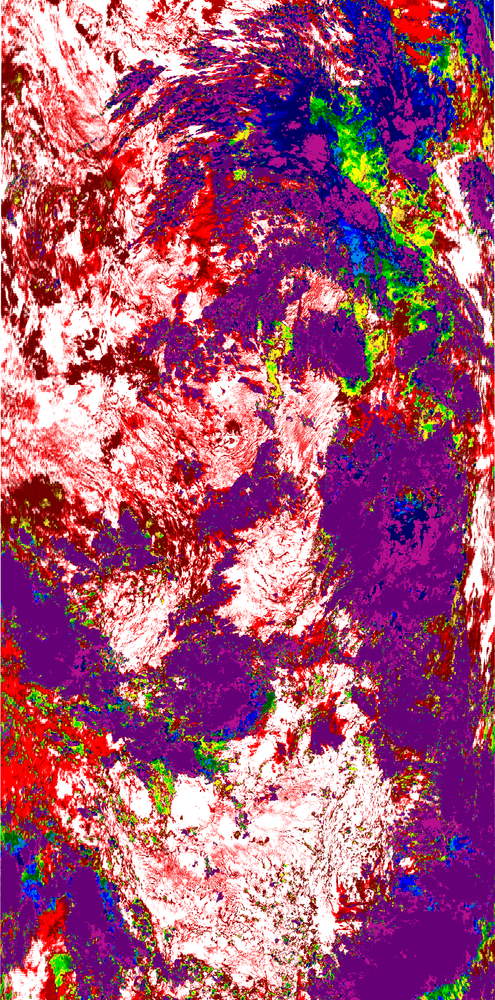

In [9]:
# Once the datasets/composites are loaded scn.show(dataset) will show them with colormap applied
scn.show('Cloud_Top_Height')

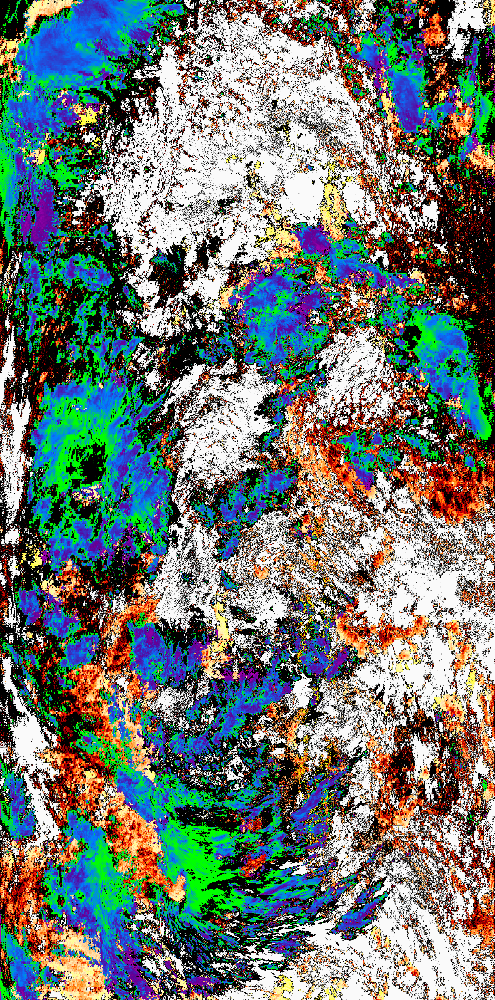

In [10]:
# One thing to note is that this images will be flipped 180 degrees vs worldview
# Converting to a pil and then flipping is one solution
# Currently flipping orientation is only supported natively by satpy for gridded datasets, which these are not.
img = scn.show("Cloud_Effective_Radius")
pil = img.pil_image()
flip_pil = pil.transpose(Image.ROTATE_180)
flip_pil